In [1]:
# !python -m torch.distributed.launch --nproc_per_node=1 --use_env main.py --coco_path /path/to/coco 

In [2]:
!python3 -V

Python 3.10.6


In [3]:
!pip show torch

Name: torch
Version: 2.0.0+cu118
Summary: Tensors and Dynamic neural networks in Python with strong GPU acceleration
Home-page: https://pytorch.org/
Author: PyTorch Team
Author-email: packages@pytorch.org
License: BSD-3
Location: /home/akaji/.local/lib/python3.10/site-packages
Requires: filelock, jinja2, networkx, sympy, triton, typing-extensions
Required-by: accelerate, torchaudio, torchvision, triton


In [4]:
import argparse
from pathlib import Path

from main import get_args_parser
import util.misc as utils


parser = argparse.ArgumentParser('DETR training and evaluation script', parents=[get_args_parser()])
# args = parser.parse_args()
args = parser.parse_args(args=[])
utils.init_distributed_mode(args)


num_classes = 2
    # the `num_classes` naming here is somewhat misleading.
    # it indeed corresponds to `max_obj_id + 1`, where max_obj_id
    # is the maximum id for a class in your dataset. For example,
    # COCO has a max_obj_id of 90, so we pass `num_classes` to be 91.
    # As another example, for a dataset that has a single class with id 1,
    # you should pass `num_classes` to be 2 (max_obj_id + 1).
    # For more details on this, check the following discussion
    # https://github.com/facebookresearch/detr/issues/108#issuecomment-650269223


if args.output_dir:
    Path(args.output_dir).mkdir(parents=True, exist_ok=True)

Not using distributed mode


In [5]:
args.eos_coef=0.5

In [6]:
args

Namespace(lr=0.0001, lr_backbone=1e-05, batch_size=2, weight_decay=0.0001, epochs=300, lr_drop=200, clip_max_norm=0.1, frozen_weights=None, backbone='resnet50', dilation=False, position_embedding='sine', enc_layers=6, dec_layers=6, dim_feedforward=2048, hidden_dim=256, dropout=0.1, nheads=8, num_queries=100, pre_norm=False, masks=False, aux_loss=True, set_cost_class=1, set_cost_bbox=5, set_cost_giou=2, mask_loss_coef=1, dice_loss_coef=1, bbox_loss_coef=5, giou_loss_coef=2, eos_coef=0.5, dataset_file='coco', coco_path=None, coco_panoptic_path=None, remove_difficult=False, output_dir='', device='cuda', seed=42, resume='', start_epoch=0, eval=False, num_workers=2, world_size=1, dist_url='env://', distributed=False)

## build_model
- build  
  - build_backbone
  - build_transformer

In [7]:
import torch

from models.backbone import build_backbone
from models.transformer import build_transformer
from models.detr import DETR, DETRsegm, SetCriterion, PostProcess
from models.matcher import build_matcher

device = torch.device(args.device)

def build_model(args, num_classes, device='cuda'):
    # the `num_classes` naming here is somewhat misleading.
    # it indeed corresponds to `max_obj_id + 1`, where max_obj_id
    # is the maximum id for a class in your dataset. For example,
    # COCO has a max_obj_id of 90, so we pass `num_classes` to be 91.
    # As another example, for a dataset that has a single class with id 1,
    # you should pass `num_classes` to be 2 (max_obj_id + 1).
    # For more details on this, check the following discussion
    # https://github.com/facebookresearch/detr/issues/108#issuecomment-650269223
    
    device = torch.device(args.device)

    backbone = build_backbone(args)

    transformer = build_transformer(args)

    model = DETR(
        backbone,
        transformer,
        num_classes=num_classes,
        num_queries=args.num_queries,
        aux_loss=args.aux_loss,
    )
    
    if args.masks:
        model = DETRsegm(model, freeze_detr=(args.frozen_weights is not None))
    model.to(device)
    
    matcher = build_matcher(args)
    weight_dict = {'loss_ce': 1, 'loss_bbox': args.bbox_loss_coef}
    weight_dict['loss_giou'] = args.giou_loss_coef
    if args.masks:
        weight_dict["loss_mask"] = args.mask_loss_coef
        weight_dict["loss_dice"] = args.dice_loss_coef
    # TODO this is a hack
    if args.aux_loss:
        aux_weight_dict = {}
        for i in range(args.dec_layers - 1):
            aux_weight_dict.update({k + f'_{i}': v for k, v in weight_dict.items()})
        weight_dict.update(aux_weight_dict)

    losses = ['labels', 'boxes', 'cardinality']
    if args.masks:
        losses += ["masks"]
    criterion = SetCriterion(num_classes-1, matcher=matcher, weight_dict=weight_dict,
                             eos_coef=args.eos_coef, losses=losses)
    criterion.to(device)
    postprocessors = {'bbox': PostProcess()}
    if args.masks:
        postprocessors['segm'] = PostProcessSegm()
        if args.dataset_file == "coco_panoptic":
            is_thing_map = {i: i <= 90 for i in range(201)}
            postprocessors["panoptic"] = PostProcessPanoptic(is_thing_map, threshold=0.85)

    return model, criterion, postprocessors

model, criterion, postprocessors = build_model(args, num_classes, device='cuda')

/home/akaji/.local/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home/akaji/.local/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [8]:
args.eos_coef

0.5

In [9]:
model_without_ddp = model
if args.distributed:
    model = torch.nn.parallel.DistributedDataParallel(model, device_ids=[args.gpu])
    model_without_ddp = model.module
n_parameters = sum(p.numel() for p in model.parameters() if p.requires_grad)
print('number of params:', n_parameters)

number of params: 41279238


## Optimizer

In [10]:
param_dicts = [
    {"params": [p for n, p in model_without_ddp.named_parameters() if "backbone" not in n and p.requires_grad]},
    {
        "params": [p for n, p in model_without_ddp.named_parameters() if "backbone" in n and p.requires_grad],
        "lr": args.lr_backbone,
    },
]

optimizer = torch.optim.AdamW(param_dicts, lr=args.lr,
                              weight_decay=args.weight_decay)
lr_scheduler = torch.optim.lr_scheduler.StepLR(optimizer, args.lr_drop)

## Dataset
- build_dataset
- DistributedSampler

In [11]:
from PIL import Image, ImageDraw

def draw_boxes(img, boxes, outline=(0, 255, 0), width=5):
    if isinstance(img, np.ndarray):
        img = Image.fromarray(img)
    im_w, im_h = img.size
    img = img.copy()
    
    img_d = ImageDraw.Draw(img)
    for bbox in boxes:
        cx, cy, w, h = bbox
        x, y = cx - w/2, cy - h/2
        x, y, w, h = x*im_w, y*im_h, w*im_w, h*im_h
        img_d.rectangle(
            [(x, y), (x + w, y + h)], outline=outline, width=width
        )

    return img


In [12]:
# from datasets import build_dataset, get_coco_api_from_dataset

# dataset_train = build_dataset(image_set='train', args=args)
# dataset_val = build_dataset(image_set='val', args=args)

import numpy as np
from datasets.coco import CocoDetection, make_coco_transforms

dataset_train = CocoDetection(img_folder=f'/home/akaji/jupyter/datasets/balloon/train', 
                              ann_file  =f'/home/akaji/jupyter/datasets/balloon/train.json',
                              transforms=make_coco_transforms('train'),
                              return_masks=args.masks)

dataset_val   = CocoDetection(img_folder=f'/home/akaji/jupyter/datasets/balloon/val', 
                              ann_file  =f'/home/akaji/jupyter/datasets/balloon/val.json',
                              transforms=make_coco_transforms('val'),
                              # transforms=None,
                              return_masks=args.masks)

loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!


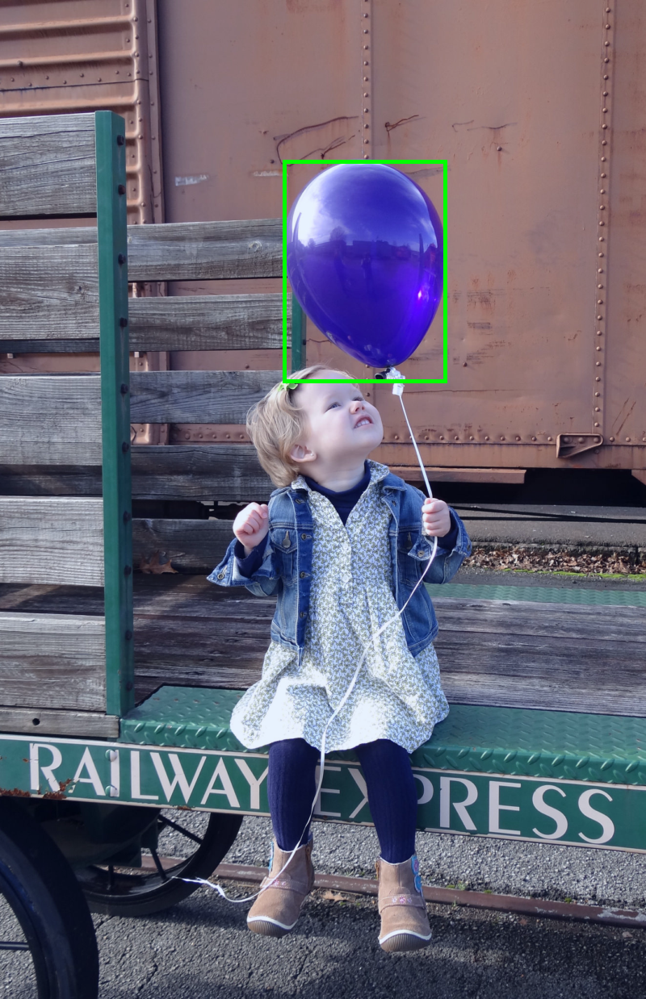

In [13]:
img_t, target = dataset_val[0]
boxes = target['boxes'].detach().cpu().numpy()

img = img_t.detach().cpu().numpy()
img = img.transpose((1, 2, 0))
val_min, val_max = img.min(), img.max()
img = (img - val_min) / (val_max - val_min)
img = (img*255).astype(np.uint8)
draw_boxes(img, boxes)

In [14]:
np.random.randint(len(dataset_train))

18

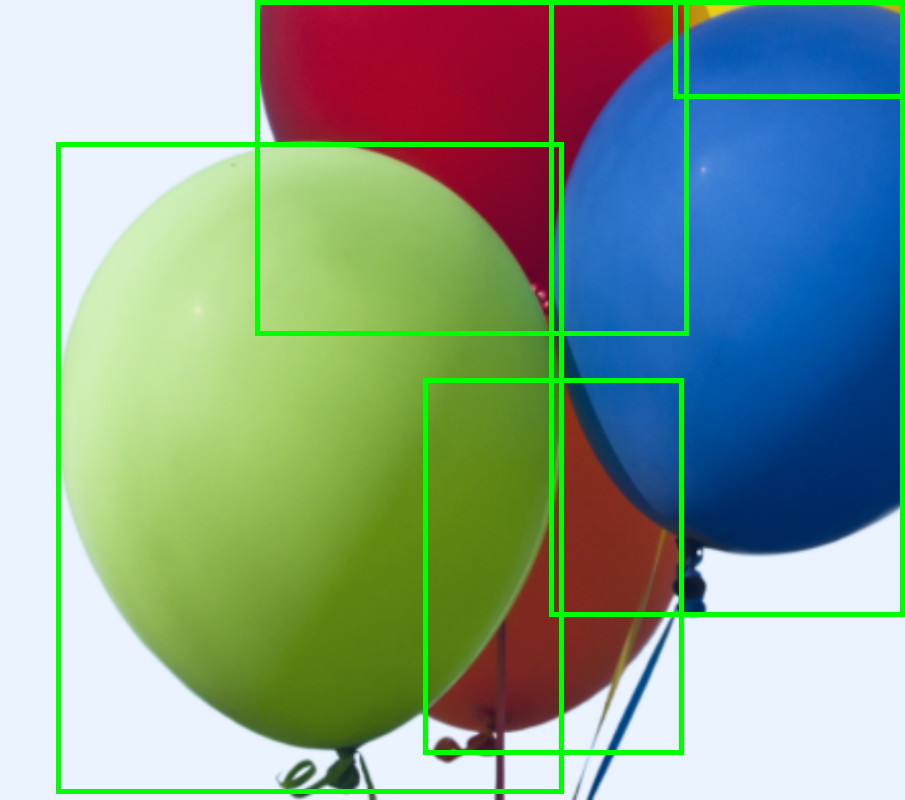

In [15]:
idx = np.random.randint(len(dataset_train))

img_t, target = dataset_train[idx]
boxes = target['boxes'].detach().cpu().numpy()

img = img_t.detach().cpu().numpy()
img = img.transpose((1, 2, 0))
val_min, val_max = img.min(), img.max()
img = (img - val_min) / (val_max - val_min)
img = (img*255).astype(np.uint8)
# print(boxes)
draw_boxes(img, boxes)

In [22]:
from torch.utils.data import DataLoader, DistributedSampler

args.num_workers = 1
args.batch_size = 8

print(args.distributed, args.num_workers, args.batch_size)
if args.distributed:
    sampler_train = DistributedSampler(dataset_train)
    sampler_val = DistributedSampler(dataset_val, shuffle=False)
else:
    sampler_train = torch.utils.data.RandomSampler(dataset_train)
    sampler_val = torch.utils.data.SequentialSampler(dataset_val)

batch_sampler_train = torch.utils.data.BatchSampler(
    sampler_train, args.batch_size, drop_last=True
)

data_loader_train = DataLoader(dataset_train, batch_sampler=batch_sampler_train,
                               collate_fn=utils.collate_fn, num_workers=args.num_workers)
data_loader_val = DataLoader(dataset_val, args.batch_size, sampler=sampler_val,
                             drop_last=False, collate_fn=utils.collate_fn, num_workers=args.num_workers)

False 1 8


In [17]:
[t.shape for t in x[0].decompose()]

NameError: name 'x' is not defined

In [ ]:
x[0].decompose()[1][0]

In [ ]:
x[1][0]['boxes'].detach().cpu().numpy()

In [ ]:
plt.imshow(dataset_val[0][0].detach().cpu().numpy()[0])

In [ ]:
dataset_val[0][1]

In [ ]:
for i,x in enumerate(data_loader_train):
    img_t = x[0].decompose()[0][0]
    print(img_t.shape)
    target = x[1][0]
    img, boxes = img_t.detach().cpu().numpy(), target['boxes'].detach().cpu().numpy()
    img = img.transpose((1, 2, 0))
    val_min, val_max = img.min(), img.max()
    img = (img - val_min) / (val_max - val_min)
    img = (img*255).astype(np.uint8)
    print(boxes)
    display(draw_boxes(img, boxes))
    break

In [ ]:
from datasets import build_dataset, get_coco_api_from_dataset

if args.dataset_file == "coco_panoptic":
    # We also evaluate AP during panoptic training, on original coco DS
    coco_val = datasets.coco.build("val", args)
    base_ds = get_coco_api_from_dataset(coco_val)
else:
    base_ds = get_coco_api_from_dataset(dataset_val)

# base_ds = dataset_val.coco

In [ ]:
assert False

In [28]:
len(dataset_val)

13

In [31]:
x[0].decompose()[0].shape, len(x[1])

(torch.Size([5, 3, 1199, 1202]), 5)

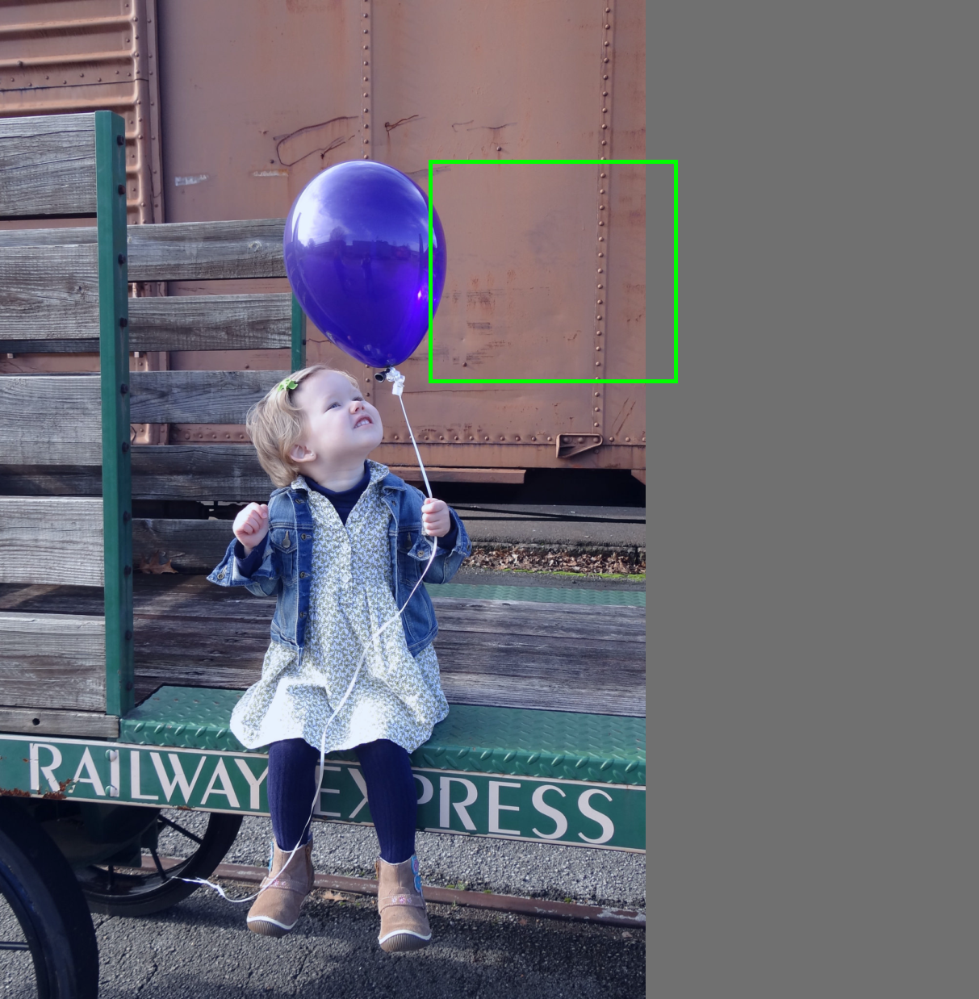

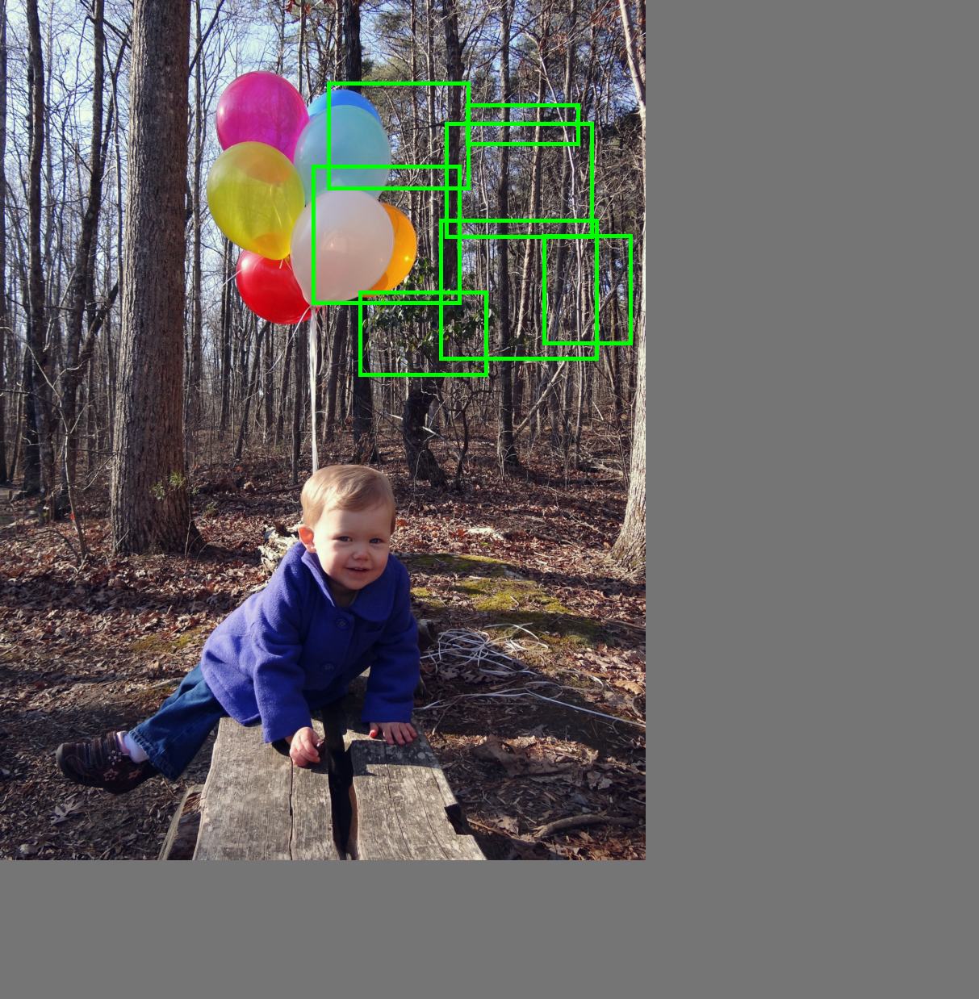

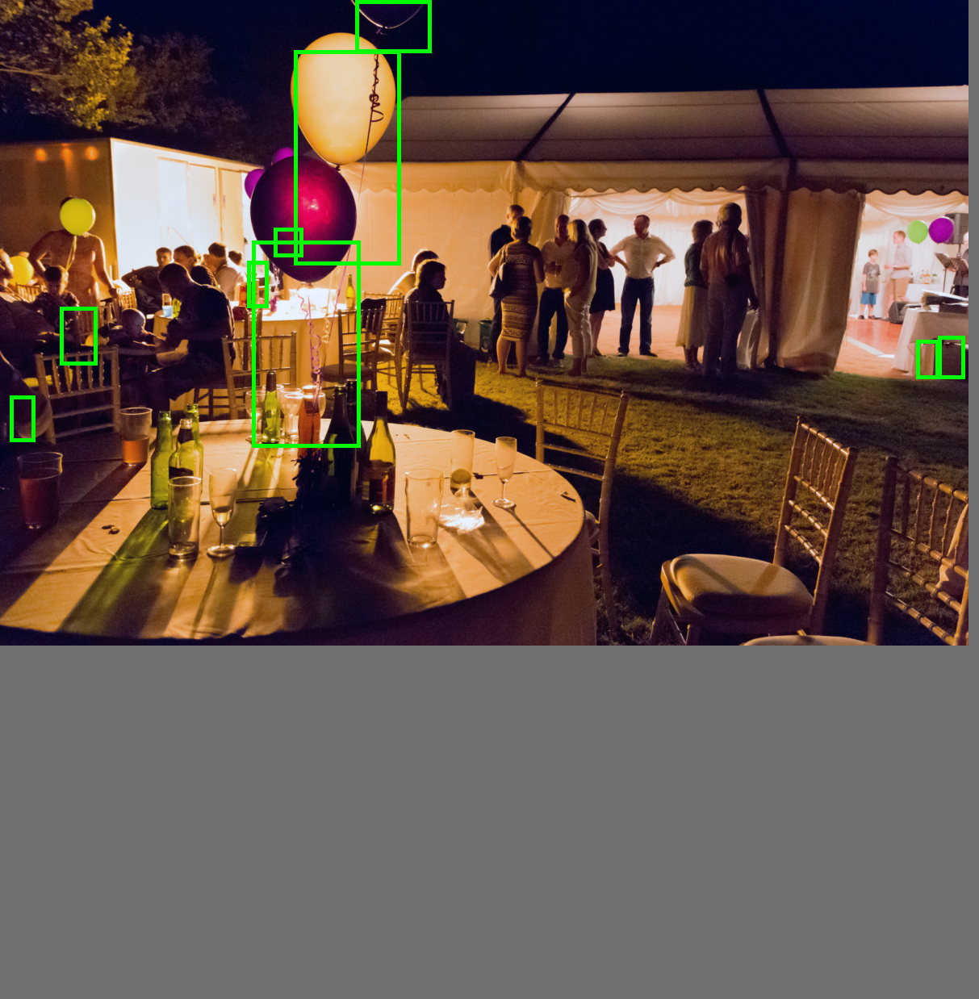

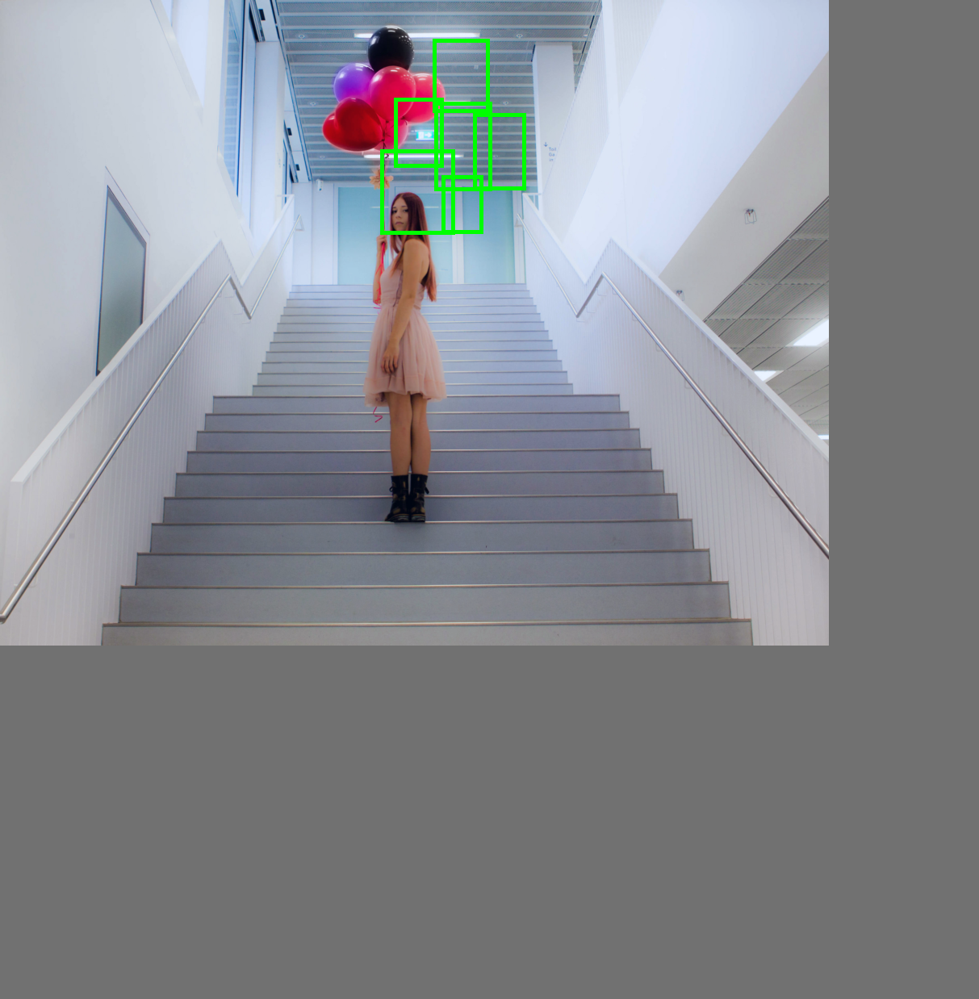

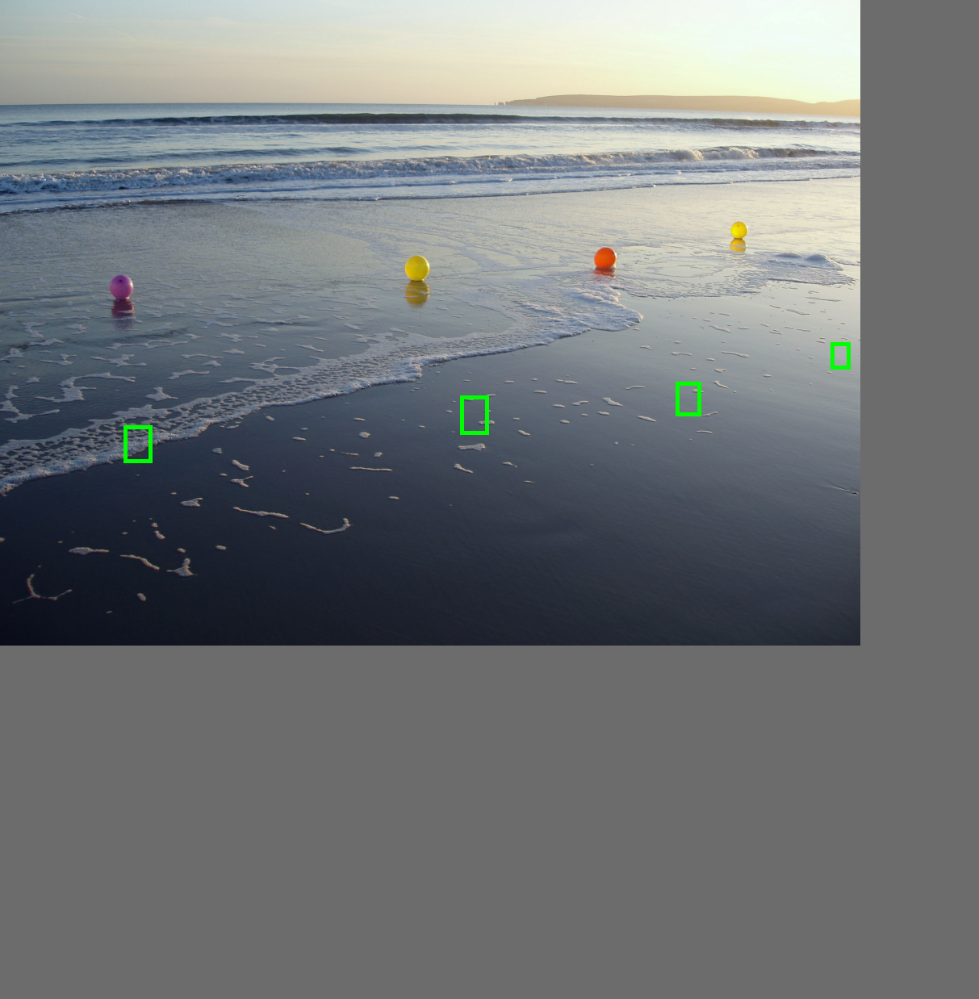

...

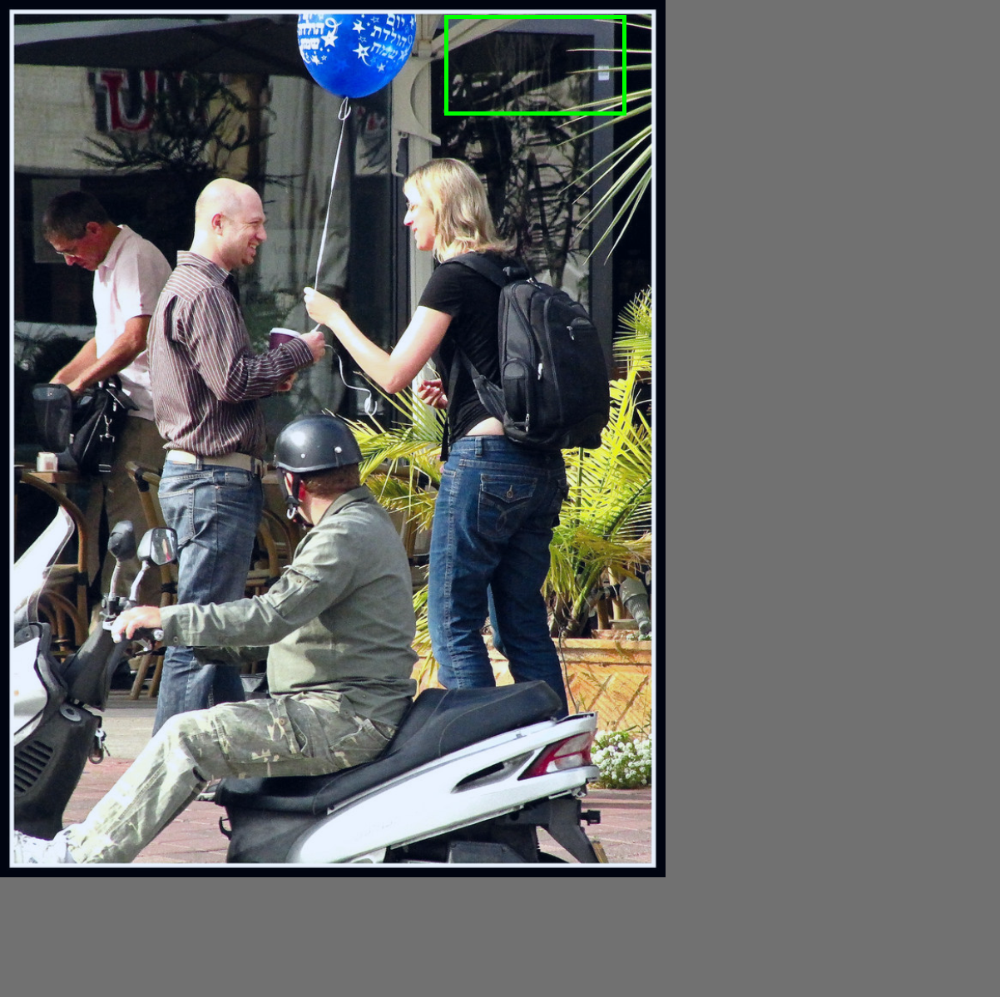

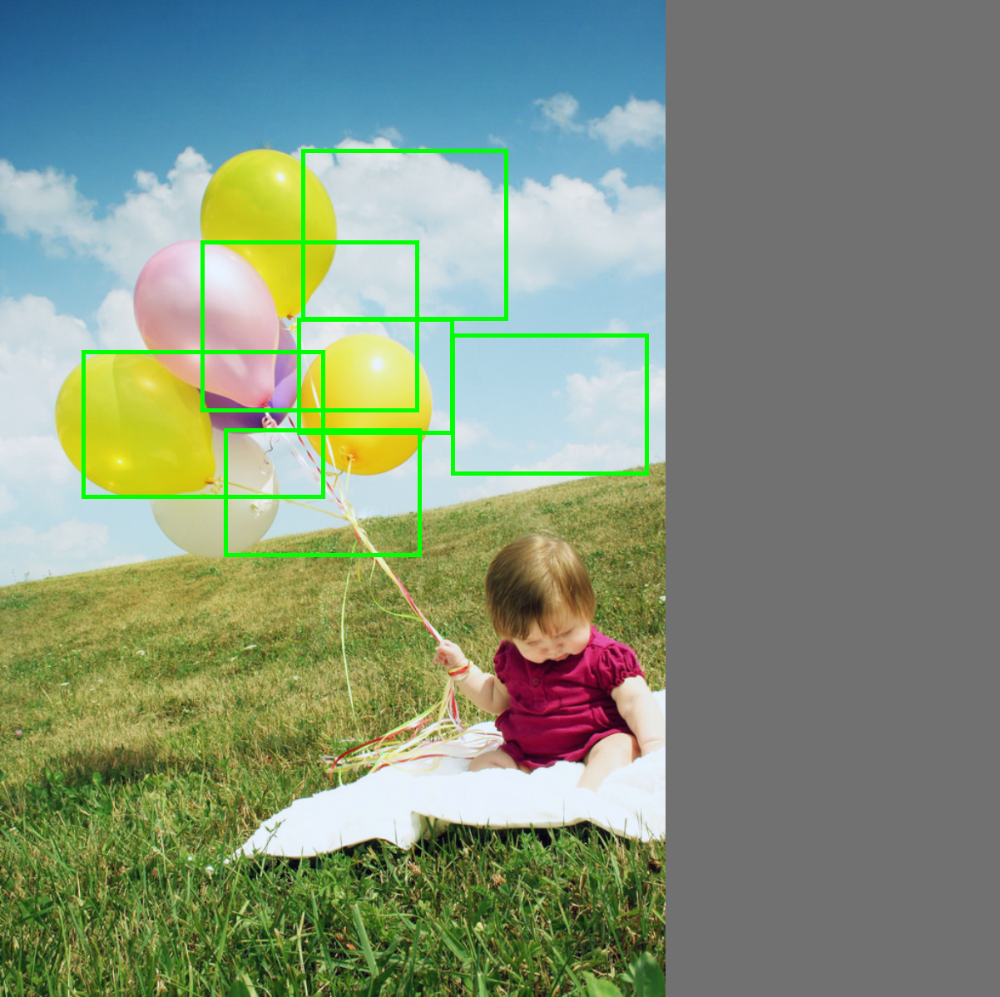

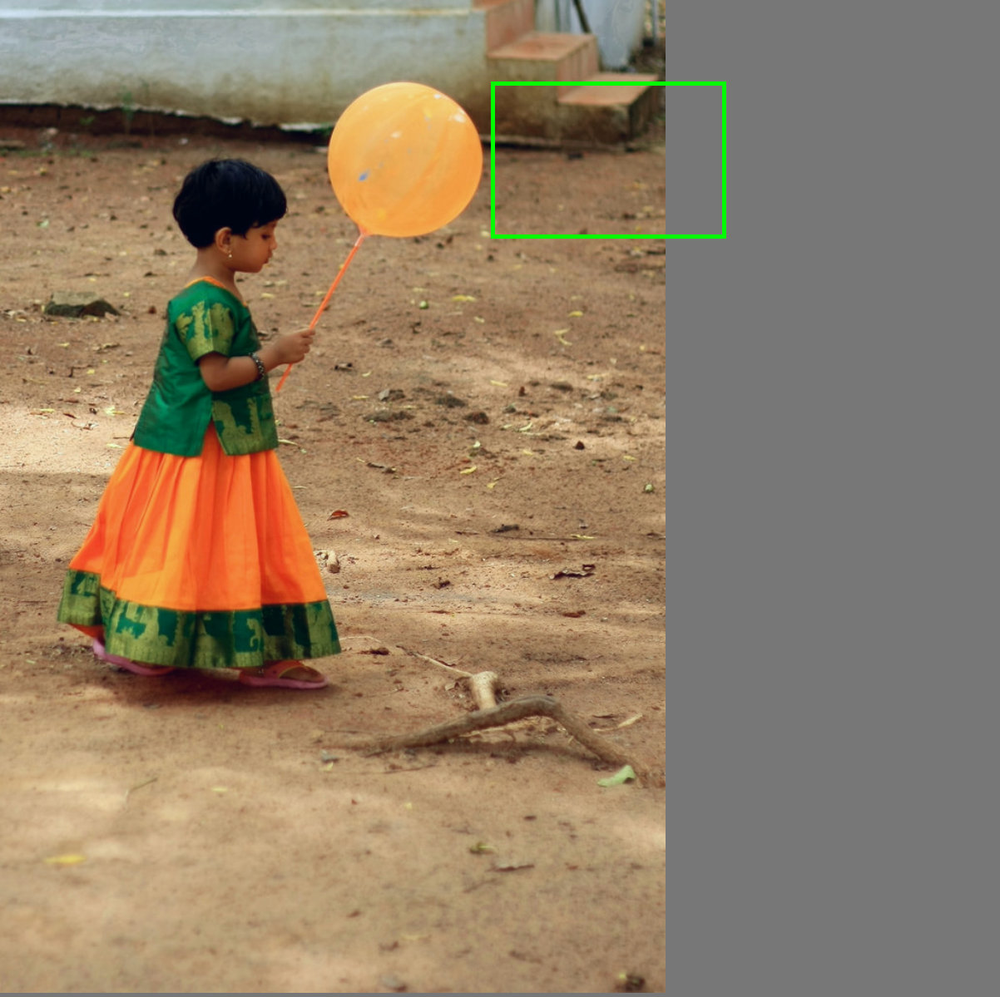

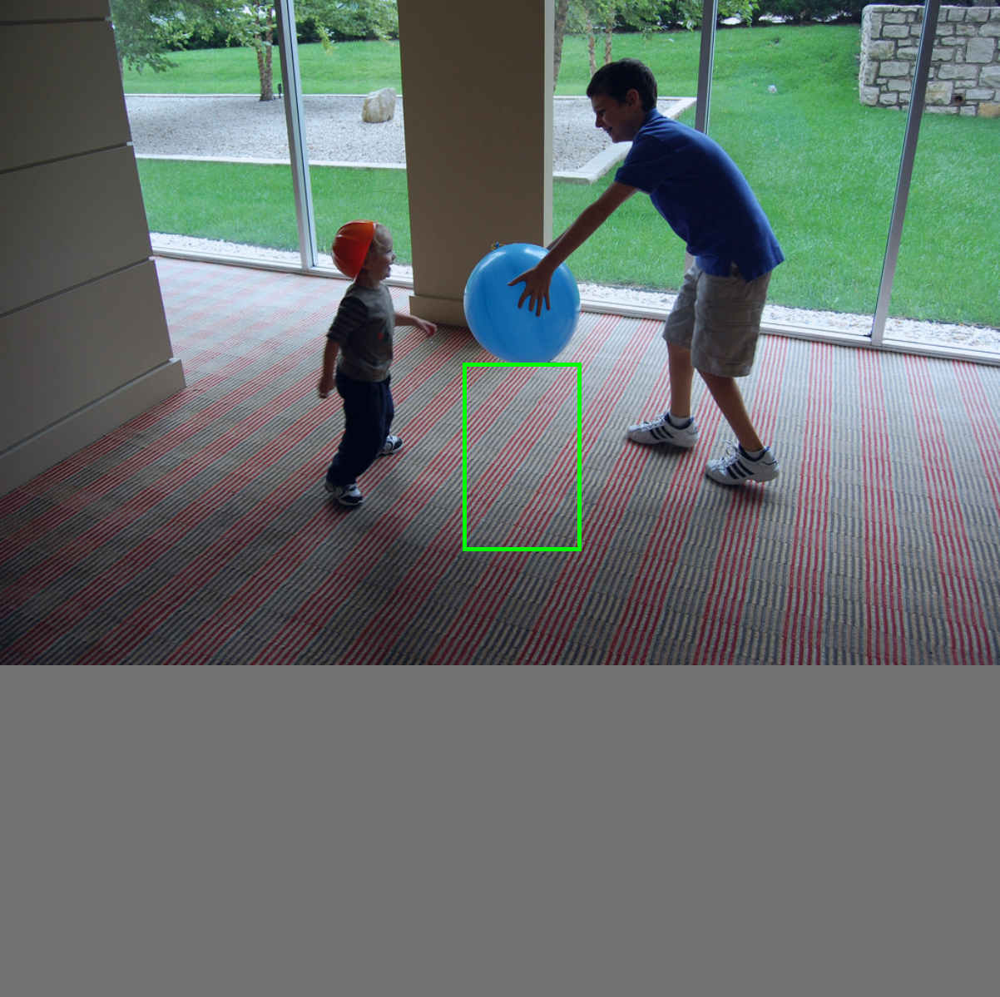

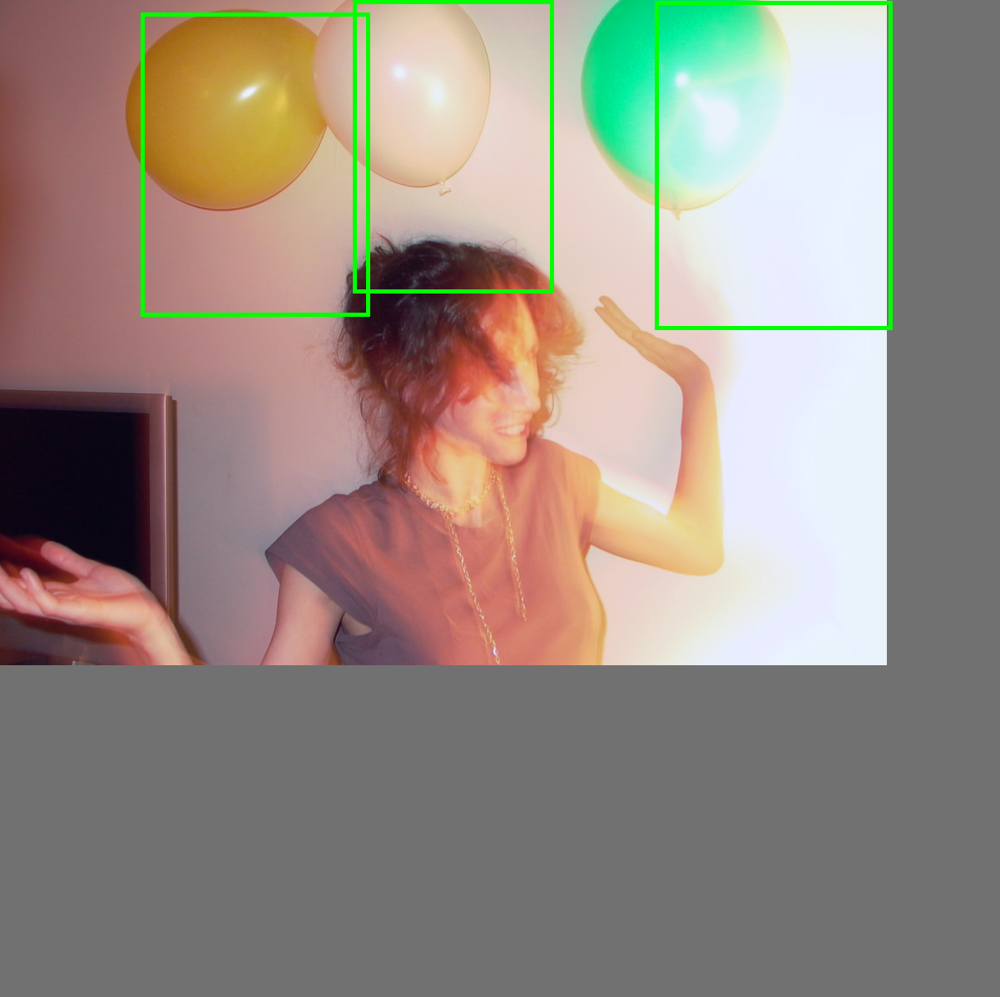

In [33]:
for i,x in enumerate(data_loader_val):
    
    imgs_t  = x[0].decompose()[0]
    targets = x[1]
    for img_t, target in zip(imgs_t, targets):    
        img, boxes = img_t.detach().cpu().numpy(), target['boxes'].detach().cpu().numpy()

        img = img.transpose((1, 2, 0))
        val_min, val_max = img.min(), img.max()
        img = (img - val_min) / (val_max - val_min)
        img = (img*255).astype(np.uint8)
        display(draw_boxes(img, boxes))

## Train

In [ ]:
if args.frozen_weights is not None:
    checkpoint = torch.load(args.frozen_weights, map_location='cpu')
    model_without_ddp.detr.load_state_dict(checkpoint['model'])
    
output_dir = Path(args.output_dir)
if args.resume:
    if args.resume.startswith('https'):
        checkpoint = torch.hub.load_state_dict_from_url(
            args.resume, map_location='cpu', check_hash=True)
    else:
        checkpoint = torch.load(args.resume, map_location='cpu')
    model_without_ddp.load_state_dict(checkpoint['model'])
    if not args.eval and 'optimizer' in checkpoint and 'lr_scheduler' in checkpoint and 'epoch' in checkpoint:
        optimizer.load_state_dict(checkpoint['optimizer'])
        lr_scheduler.load_state_dict(checkpoint['lr_scheduler'])
        args.start_epoch = checkpoint['epoch'] + 1

In [ ]:
# # if Evalueate
# from engine import evaluate


# if args.eval:
#     test_stats, coco_evaluator = evaluate(model, criterion, postprocessors,
#                                           data_loader_val, base_ds, device, args.output_dir)
#     if args.output_dir:
#         utils.save_on_master(coco_evaluator.coco_eval["bbox"].eval, output_dir / "eval.pth")
#     return

In [ ]:
model.class_embed

In [ ]:
import time
import datetime
from engine import evaluate, train_one_epoch

args.epochs=1000

print("Start training")
start_time = time.time()
for epoch in range(args.start_epoch, args.epochs):
    if args.distributed:
        sampler_train.set_epoch(epoch)
    train_stats = train_one_epoch(
        model, criterion, data_loader_train, optimizer, device, epoch,
        args.clip_max_norm)
    lr_scheduler.step()
    if args.output_dir:
        checkpoint_paths = [output_dir / 'checkpoint.pth']
        # extra checkpoint before LR drop and every 100 epochs
        if (epoch + 1) % args.lr_drop == 0 or (epoch + 1) % 100 == 0:
            checkpoint_paths.append(output_dir / f'checkpoint{epoch:04}.pth')
        for checkpoint_path in checkpoint_paths:
            utils.save_on_master({
                'model': model_without_ddp.state_dict(),
                'optimizer': optimizer.state_dict(),
                'lr_scheduler': lr_scheduler.state_dict(),
                'epoch': epoch,
                'args': args,
            }, checkpoint_path)

    test_stats, coco_evaluator = evaluate(
        model, criterion, postprocessors, data_loader_val, base_ds, device, args.output_dir
    )

    log_stats = {**{f'train_{k}': v for k, v in train_stats.items()},
                 **{f'test_{k}': v for k, v in test_stats.items()},
                 'epoch': epoch,
                 'n_parameters': n_parameters}

    if args.output_dir and utils.is_main_process():
        with (output_dir / "log.txt").open("a") as f:
            f.write(json.dumps(log_stats) + "\n")

        # for evaluation logs
        if coco_evaluator is not None:
            (output_dir / 'eval').mkdir(exist_ok=True)
            if "bbox" in coco_evaluator.coco_eval:
                filenames = ['latest.pth']
                if epoch % 50 == 0:
                    filenames.append(f'{epoch:03}.pth')
                for name in filenames:
                    torch.save(coco_evaluator.coco_eval["bbox"].eval,
                               output_dir / "eval" / name)

total_time = time.time() - start_time
total_time_str = str(datetime.timedelta(seconds=int(total_time)))
print('Training time {}'.format(total_time_str))

In [ ]:
im, target = dataset_val[0]

In [ ]:
im.unsqueeze(0).shape

In [ ]:
pred = model(im.unsqueeze(0).to(device))
pred.keys()

In [ ]:
pred['pred_boxes'].shape

In [ ]:
# output['pred_logits'][i].softmax(1).detach().cpu().numpy()[:,0]
pred['pred_logits'][0].softmax(1).detach().cpu().numpy()[:,0]
# pred

In [ ]:
len(pred['aux_outputs'])